In [2]:
%load_ext autoreload
%autoreload 2

In [1]:
import os
print(os.cpu_count())

import copy
import wandb
import random
import pandas as pd
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt

import torch
from torchvision.io import read_image
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torch.optim as optim
from torch import nn
import torch.backends.cudnn as cudnn

import albumentations as A
from albumentations.pytorch import ToTensorV2

import albumentations as A
from albumentations.pytorch import ToTensorV2

from colorama import Fore, Style
b_ = Fore.BLUE
sr_ = Style.RESET_ALL

30


INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.12 (you have 1.4.11). Upgrade using: pip install --upgrade albumentations


In [3]:
def set_seed(seed):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)  # if you are using multi-GPU.
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    torch.set_float32_matmul_precision('highest')

# Set the random seed
set_seed(42)

In [3]:
def add_path(row):
    return f"../data/train-image/image/{row.isic_id}.jpg"

train_metadata_df = pd.read_csv("../data/stratified_5_fold_train_metadata.csv")
train_metadata_df["path"] = train_metadata_df.apply(lambda row: add_path(row), axis=1)


class SkinDataset(Dataset):
    def __init__(self, df: pd.DataFrame, transform=None, target_transform=None):
        assert "path" in df.columns
        assert "target" in df.columns

        self.paths = df.path.tolist()
        self.labels = df.target.tolist() # binary
        self.transform = transform
        self.target_transform = target_transform

    def __len__(self):
        return len(self.paths)

    def __getitem__(self, idx: int):
        image = read_image(self.paths[idx]).to(torch.float32) / 255.0
        label = self.labels[idx] / 1.0
        if self.transform:
            image = image.numpy().transpose((1,2,0))
            image = self.transform(image=image)["image"]
        if self.target_transform:
            label = self.target_transform(label)
        return image, label

    def get_class_samples(self, class_label):
        indices = [i for i, label in enumerate(self.labels) if label == class_label]
        return indices

/tmp/ipykernel_1770455/3766624704.py:4: DtypeWarning: Columns (51,52) have mixed types. Specify dtype option on import or set low_memory=False.
  train_metadata_df = pd.read_csv("../data/stratified_5_fold_train_metadata.csv")


In [4]:
train_df = train_metadata_df.loc[train_metadata_df.fold == 0] # using a subset for training

train_dataset = SkinDataset(train_df, transform=None)
train_dataloader = DataLoader(train_dataset, batch_size=1, shuffle=True, num_workers=24, pin_memory=True, persistent_workers=True, drop_last=True)

In [5]:
def compute_image_statistics(dataloader):
    heights = []
    widths = []

    for images, _ in dataloader:
        for image in images:
            _, height, width = image.shape
            heights.append(height)
            widths.append(width)
    
    # Convert to numpy arrays for easy computation
    heights = np.array(heights)
    widths = np.array(widths)

    mean_height = np.mean(heights)
    median_height = np.median(heights)
    std_height = np.std(heights)

    mean_width = np.mean(widths)
    median_width = np.median(widths)
    std_width = np.std(widths)

    print(f"Mean Height: {mean_height:.2f}")
    print(f"Median Height: {median_height:.2f}")
    print(f"Std Dev Height: {std_height:.2f}")
    print(f"Mean Width: {mean_width:.2f}")
    print(f"Median Width: {median_width:.2f}")
    print(f"Std Dev Width: {std_width:.2f}")

    return {
        'mean_height': mean_height,
        'median_height': median_height,
        'std_height': std_height,
        'mean_width': mean_width,
        'median_width': median_width,
        'std_width': std_width
    }

# Usage
stats = compute_image_statistics(train_dataloader)

Mean Height: 133.26
Median Height: 131.00
Std Dev Height: 18.56
Mean Width: 133.26
Median Width: 131.00
Std Dev Width: 18.56


In [57]:
# image calculated mean and std
mean=(0.6962, 0.5209, 0.4193)
std=(0.1395, 0.1320, 0.1240)

imagenet_mean = (0.485, 0.456, 0.406)
imagenet_std = (0.229, 0.224, 0.225)

In [6]:
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader


def get_samples(dataloader, num_samples=5):
    # Collect samples
    positive_samples = []
    negative_samples = []

    for images, labels in dataloader:
        for image, label in zip(images, labels):
            if label == 1.0 and len(positive_samples) < num_samples:
                positive_samples.append(image)
            elif label == 0.0 and len(negative_samples) < num_samples:
                negative_samples.append(image)
            if len(positive_samples) >= num_samples and len(negative_samples) >= num_samples:
                break
        if len(positive_samples) >= num_samples and len(negative_samples) >= num_samples:
            break
    
    return positive_samples, negative_samples

In [7]:
positive_samples, negative_samples = get_samples(train_dataloader)

In [93]:
def plot_samples(positive_samples, negative_samples, num_samples=5, transform=None):
    # Helper function to display images
    def imshow(img, ax, is_transformed=False):
        if is_transformed:
            npimg = (img.numpy().transpose((1,2,0)) * np.array(imagenet_std) + np.array(imagenet_mean)) * 255
        else:
            npimg = img.numpy().transpose((1,2,0))
        ax.imshow(npimg)
        ax.axis('off')

    fig, axs = plt.subplots(4, num_samples, figsize=(15, 10))

    # Plot original positive samples
    for i, sample in enumerate(positive_samples):
        imshow(sample, axs[0, i])
        axs[0, i].set_title("Positive")

    # Plot augmented positive samples
    for i, sample in enumerate(positive_samples):
        if transform:
            sample = sample.numpy().transpose((1, 2, 0))
            sample = transform(image=sample)["image"]
            # sample = torch.tensor(sample).permute(2, 0, 1)  # Convert back to tensor
        imshow(sample, axs[1, i], is_transformed=True)
        axs[1, i].set_title("Augmented Positive")

    # Plot original negative samples
    for i, sample in enumerate(negative_samples):
        imshow(sample, axs[2, i])
        axs[2, i].set_title("Negative")

    # Plot augmented negative samples
    for i, sample in enumerate(negative_samples):
        if transform:
            sample = sample.numpy().transpose((1, 2, 0))
            sample = transform(image=sample)["image"]
        imshow(sample, axs[3, i], is_transformed=True)
        axs[3, i].set_title("Augmented Negative")

    plt.tight_layout()
    plt.show()

## Simple transform

In [98]:
transforms = A.Compose([
    A.Resize(124, 124),
    A.Normalize(),
    ToTensorV2(),
])

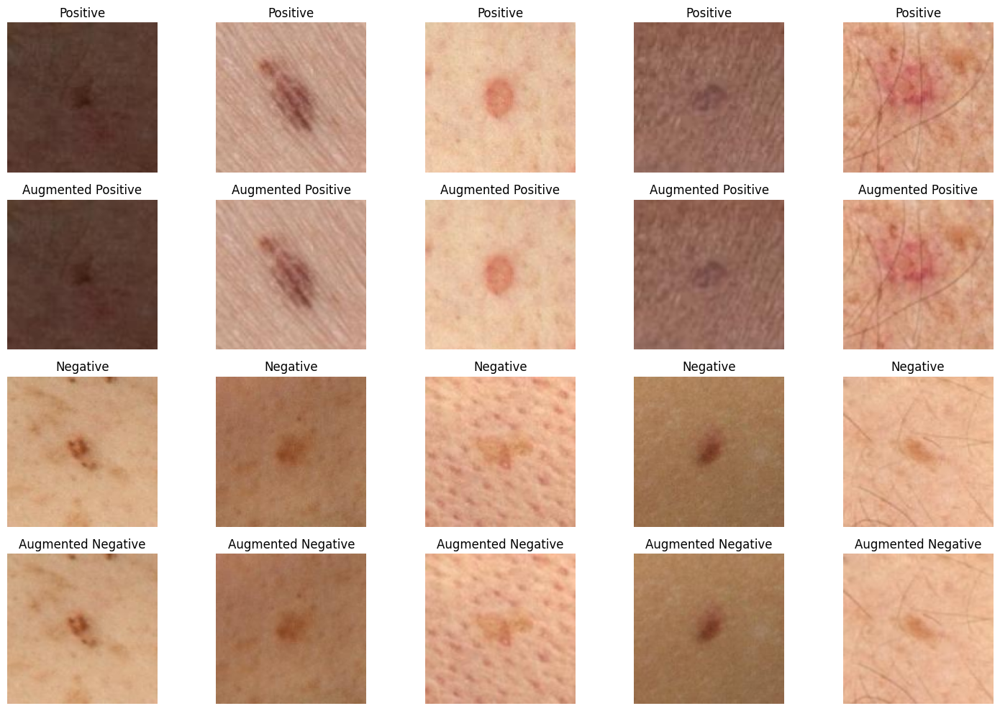

In [99]:
plot_samples(positive_samples, negative_samples, num_samples=5, transform=transforms)

## Random rotate and flip

In [108]:
transforms = A.Compose([
    A.Resize(124, 124),
    A.RandomRotate90(p=0.5),
    A.Flip(p=0.5),
    A.Normalize(),
    ToTensorV2(),
])

plot_samples(positive_samples, negative_samples, num_samples=5, transform=transforms)

/home/ubuntu/.local/lib/python3.10/site-packages/pydantic/main.py:308: UserWarning: Pydantic serializer warnings:
  Expected `Union[float, json-or-python[json=list[float], python=list[float]]]` but got `tuple` - serialized value may not be as expected
  Expected `Union[float, json-or-python[json=list[float], python=list[float]]]` but got `tuple` - serialized value may not be as expected
  return self.__pydantic_serializer__.to_python(


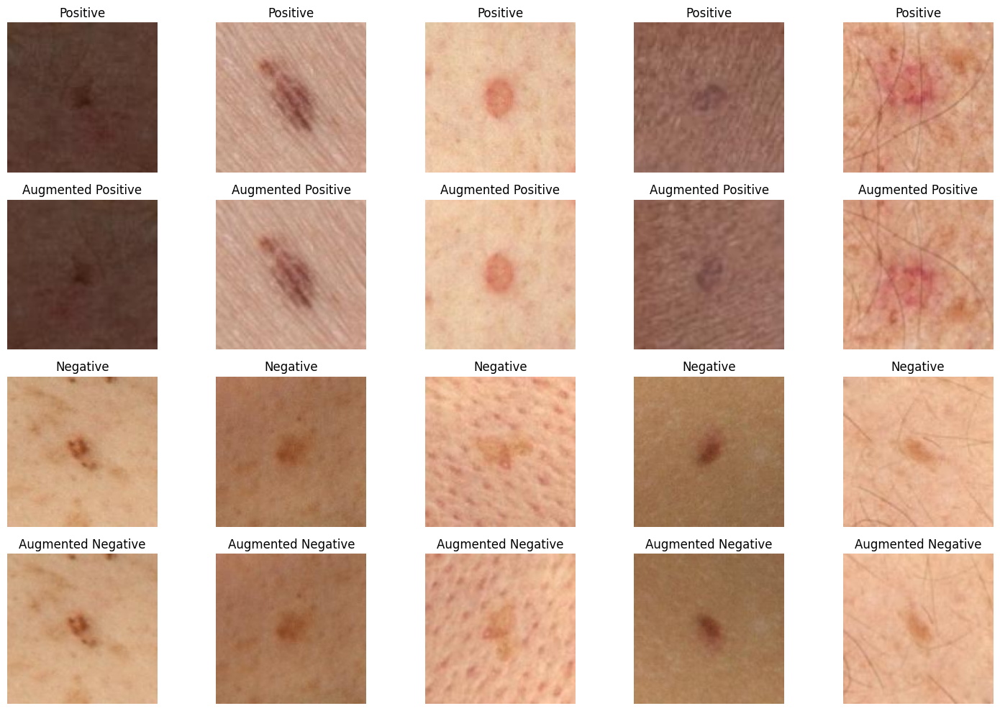

In [109]:
plot_samples(positive_samples, negative_samples, num_samples=5, transform=transforms)

## ShiftScaleRotate

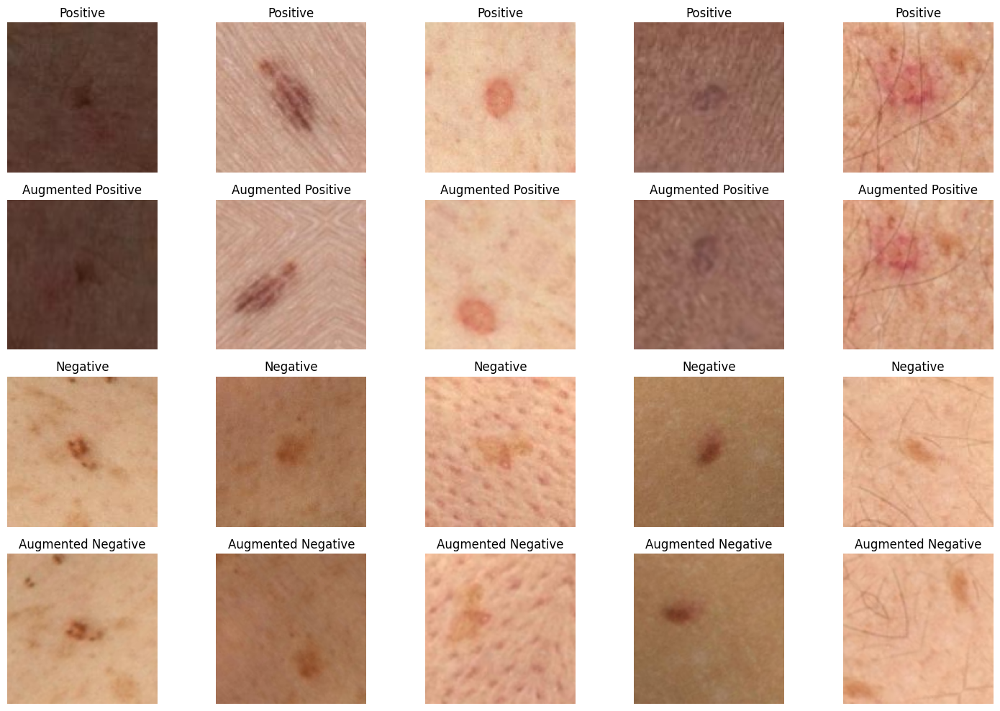

In [116]:
transforms = A.Compose([
    A.Resize(124, 124),
    A.ShiftScaleRotate(
        shift_limit=0.3, scale_limit=0.15, rotate_limit=90, p=1.0
    ),
    A.Normalize(),
    ToTensorV2(),
])

plot_samples(positive_samples, negative_samples, num_samples=5, transform=transforms)

## HueSaturationValue

/home/ubuntu/.local/lib/python3.10/site-packages/pydantic/main.py:308: UserWarning: Pydantic serializer warnings:
  Expected `Union[float, json-or-python[json=list[float], python=list[float]]]` but got `tuple` - serialized value may not be as expected
  Expected `Union[float, json-or-python[json=list[float], python=list[float]]]` but got `tuple` - serialized value may not be as expected
  return self.__pydantic_serializer__.to_python(


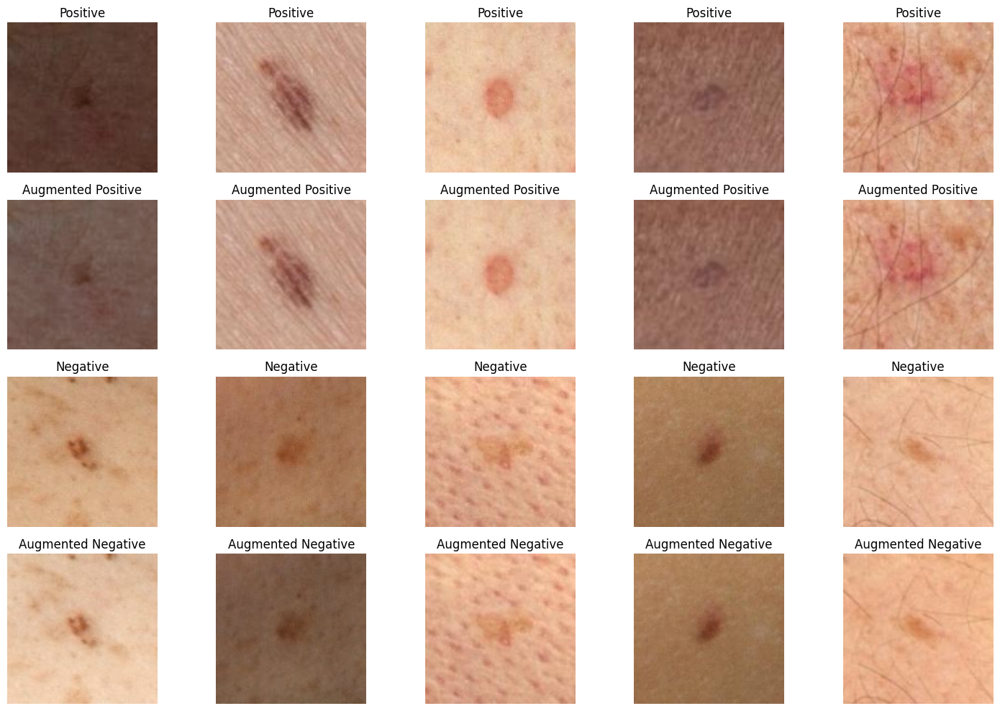

In [119]:
transforms = A.Compose([
    A.Resize(124, 124),
    A.HueSaturationValue(
        hue_shift_limit=0.2, sat_shift_limit=0.2, val_shift_limit=0.2, p=0.5
    ),
    A.Normalize(),
    ToTensorV2(),
])

plot_samples(positive_samples, negative_samples, num_samples=5, transform=transforms)

## RandomBrightnessContrast

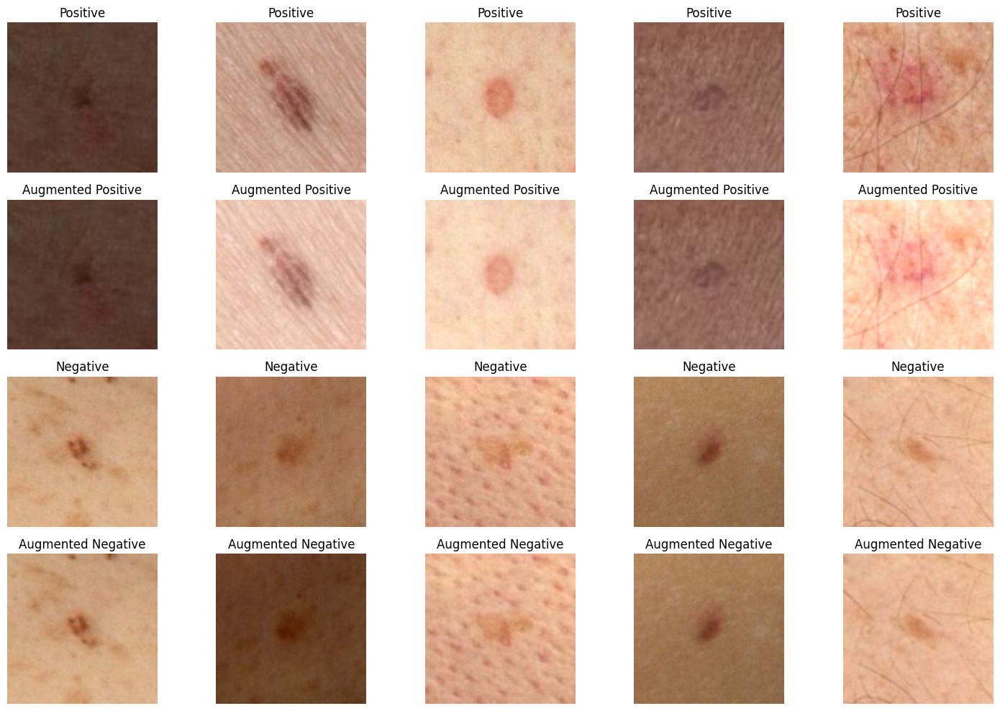

In [124]:
transforms = A.Compose([
    A.Resize(124, 124),
    A.RandomBrightnessContrast(
        brightness_limit=(-0.2, 0.2), contrast_limit=(-0.2, 0.2), p=0.5
    ),
    A.Normalize(),
    ToTensorV2(),
])

plot_samples(positive_samples, negative_samples, num_samples=5, transform=transforms)

## CLAHE

In [180]:
def plot_clahe_results(clahe_results):
    """
    Plots the CLAHE results.

    Parameters:
    - clahe_results: Dictionary with keys as (clip_limit, tile_grid_size) tuples and values as processed images.
    """
    num_results = len(clahe_results)
    cols = 3
    rows = (num_results + cols - 1) // cols

    plt.figure(figsize=(15, 5 * rows))
    for idx, ((clip_limit, tile_grid_size), clahe_image) in enumerate(clahe_results.items()):
        plt.subplot(rows, cols, idx + 1)
        plt.imshow(clahe_image, cmap='gray')
        plt.title(f'Clip Limit: {clip_limit}, Tile Grid Size: {tile_grid_size}')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

In [182]:
_positive_samples = [(img * 255).to(torch.uint8) for img in positive_samples]
_negative_samples = [(img * 255).to(torch.uint8) for img in negative_samples]

In [184]:
clip_limits = [2.0, 3.0, 4.0, 6.0, 7.0, 10.0, 11.0, 13.0, 15.0]
tile_grid_sizes = [4, 6, 8, 10, 12, 14, 16, 18]


def apply_clahe(image, clip_limits, tile_grid_sizes):
    clahe_results = {}
    
    for clip_limit in clip_limits:
        for tile_grid_size in tile_grid_sizes:
            transforms = A.Compose([
                A.Resize(124, 124),
                A.CLAHE(
                    clip_limit=clip_limit, tile_grid_size=(tile_grid_size, tile_grid_size), p=1.0
                ),
                ToTensorV2(),
            ])
            clahe_image = transforms(image=image.numpy().transpose((1,2,0)))["image"].numpy().transpose((1,2,0))
            clahe_results[(clip_limit, tile_grid_size)] = clahe_image
    
    return clahe_results

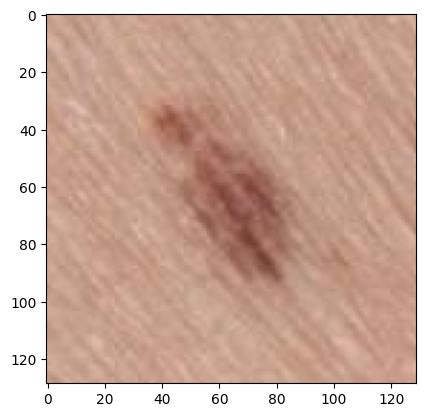

In [193]:
plt.imshow(_positive_samples[1].numpy().transpose((1,2,0)))

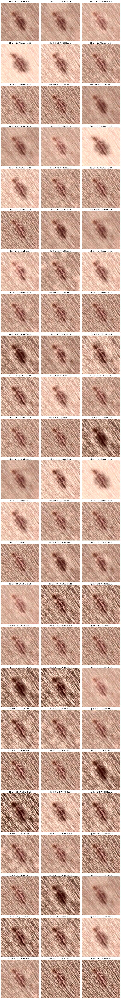

In [188]:
clahe_results = apply_clahe(_positive_samples[1], clip_limits, tile_grid_sizes)
plot_clahe_results(clahe_results)

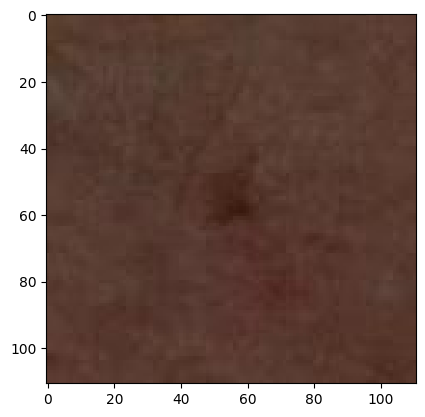

In [197]:
plt.imshow(_positive_samples[0].numpy().transpose((1,2,0)))

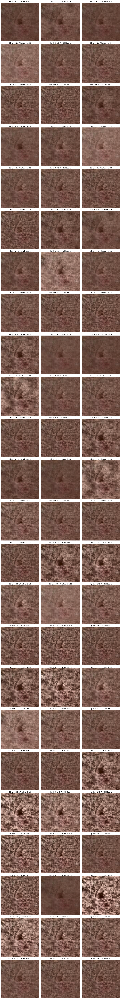

In [189]:
clahe_results = apply_clahe(_positive_samples[0], clip_limits, tile_grid_sizes)
plot_clahe_results(clahe_results)

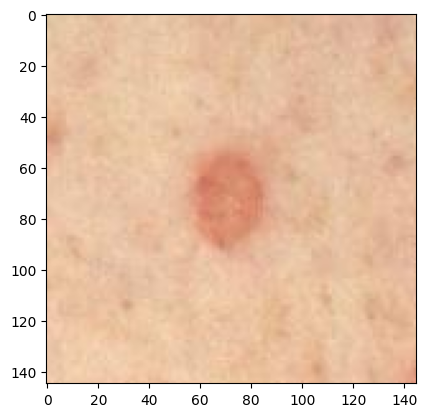

In [195]:
plt.imshow(_positive_samples[2].numpy().transpose((1,2,0)))

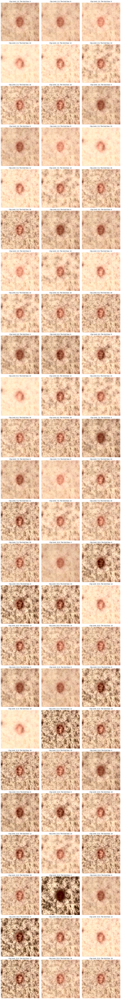

In [190]:
clahe_results = apply_clahe(_positive_samples[2], clip_limits, tile_grid_sizes)
plot_clahe_results(clahe_results)

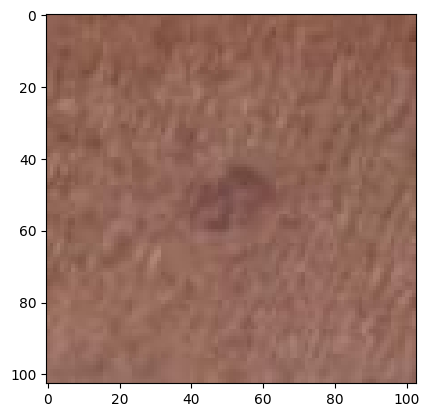

In [196]:
plt.imshow(_positive_samples[3].numpy().transpose((1,2,0)))

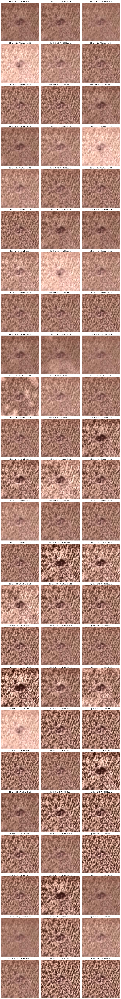

In [191]:
clahe_results = apply_clahe(_positive_samples[3], clip_limits, tile_grid_sizes)
plot_clahe_results(clahe_results)

## Putting together

In [209]:
transforms = A.Compose([
    A.Resize(124, 124),
    A.ShiftScaleRotate(
        shift_limit=0.2, scale_limit=0.15, rotate_limit=90, p=1.0
    ),
    A.HueSaturationValue(
        hue_shift_limit=0.2, sat_shift_limit=0.2, val_shift_limit=0.2, p=0.5
    ),
    A.RandomBrightnessContrast(
        brightness_limit=(-0.2, 0.2), contrast_limit=(-0.2, 0.2), p=0.5
    ),
    A.Normalize(),
    ToTensorV2(),
])

/home/ubuntu/.local/lib/python3.10/site-packages/pydantic/main.py:308: UserWarning: Pydantic serializer warnings:
  Expected `Union[float, json-or-python[json=list[float], python=list[float]]]` but got `tuple` - serialized value may not be as expected
  Expected `Union[float, json-or-python[json=list[float], python=list[float]]]` but got `tuple` - serialized value may not be as expected
  return self.__pydantic_serializer__.to_python(


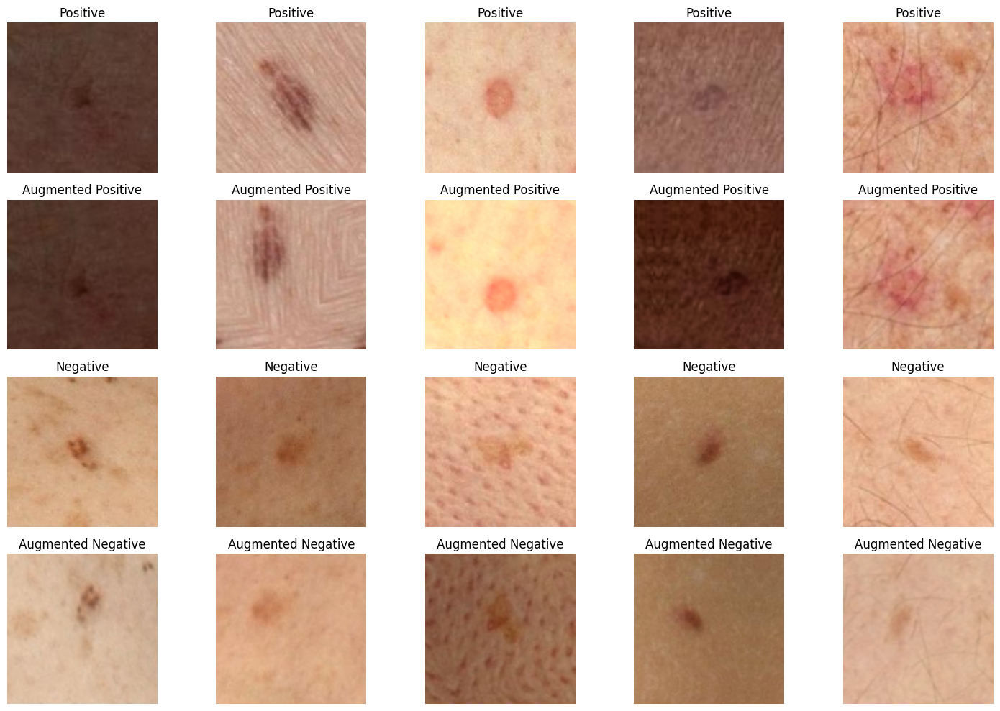

In [210]:
plot_samples(positive_samples, negative_samples, num_samples=5, transform=transforms)

## 

In [248]:
transforms = A.Compose([
    A.Resize(224, 224),
    A.RandomResizedCrop(
        size=124,  # ScaleIntType | None
        width=124,  # int | None
        height=124,  # int | None
        scale=(0.08, 1.0),  # tuple[float, float]
        ratio=(0.45, 0.75),  # tuple[float, float]
        interpolation=1,  # <class 'int'>
        always_apply=None,  # bool | None
        p=1.0,  # float
    ),
    A.HueSaturationValue(
        hue_shift_limit=0.2, sat_shift_limit=0.2, val_shift_limit=0.2, p=0.5
    ),
    A.RandomBrightnessContrast(
        brightness_limit=(-0.2, 0.2), contrast_limit=(-0.2, 0.2), p=0.5
    ),
    A.Normalize(),
    ToTensorV2(),
])

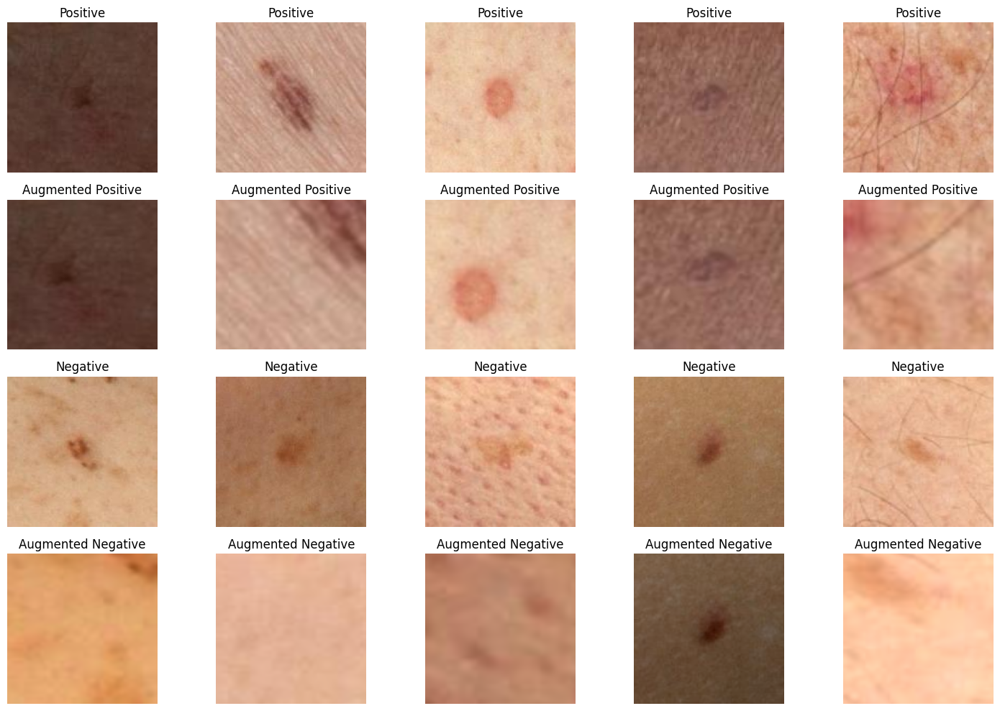

In [249]:
plot_samples(positive_samples, negative_samples, num_samples=5, transform=transforms)

In [250]:
transforms = A.Compose([
    A.Resize(224, 224),
    A.CenterCrop(
        height=128,
        width=128,
        p=1.0,
    ),
    # A.ShiftScaleRotate(
    #     shift_limit=0.1, scale_limit=0.15, rotate_limit=60, p=0.5
    # ),
    A.HueSaturationValue(
        hue_shift_limit=0.2, sat_shift_limit=0.2, val_shift_limit=0.2, p=0.5
    ),
    A.RandomBrightnessContrast(
        brightness_limit=(-0.1, 0.1), contrast_limit=(-0.1, 0.1), p=0.5
    ),
    A.RandomRotate90(p=0.5),
    A.Flip(p=0.5),
    A.Normalize(),
    ToTensorV2(),
])

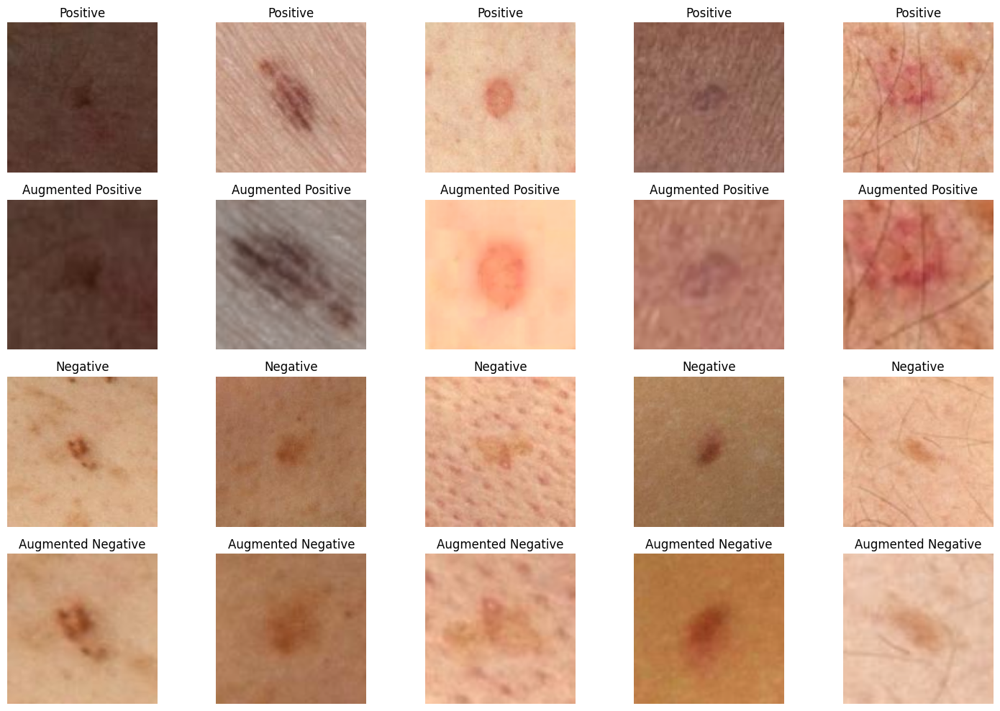

In [251]:
plot_samples(positive_samples, negative_samples, num_samples=5, transform=transforms)